In [1]:
%%capture
%pip install torch==2.2.1+cu118 --index-url https://download.pytorch.org/whl/cu118
%pip install C:\Users\ncccc\Desktop\LAVIS
%pip install -r C:\Users\ncccc\Desktop\LAVIS\requirements.txt

Looking in indexes: https://download.pytorch.org/whl/cu118Note: you may need to restart the kernel to use updated packages.



In [2]:
import torch

from PIL import Image
from lavis.models import load_model_and_preprocess

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [3]:
torch.cuda.is_available()

True

In [3]:
model, vis_preprocess, txt_preprocess = load_model_and_preprocess("blip_diffusion", "base", device="cuda", is_eval=True)

  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)



No ctx_embeddings_cache found in C:\Users\ncccc/.cache\torch\hub\checkpoints\blip-diffusion


### Description
This demo shows how to edit a **real** image with a given subject as condition. It works in the following steps:

(1) run DDIM inversion on the given image using prompt ``A ${src_subject} ${prompt}.``;

(2) extracting BLIP-2 embeddings on condition subject image, using ``cond_subject`` and ``cond_image``.

(3) edit the real image with the subject visuals, using the prompt ``A ${BLIP-2 embedding} ${tgt_subject} ${prompt}`` and the DDIM inverted latents.

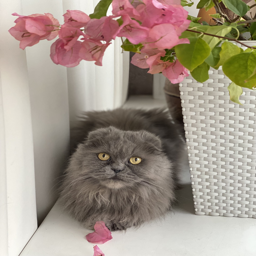

In [24]:
cond_subject = "gray cat"
src_subject = "grass"
tgt_subject = "gray cat"

text_prompt = "on the grass"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/pushok-2.jpeg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/grass.jpg").convert("RGB")


100%|██████████| 50/50 [00:03<00:00, 15.15it/s]


['a grass on the grass', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks gray cat on the grass']


100%|██████████| 50/50 [00:10<00:00,  4.77it/s]


Before editing:


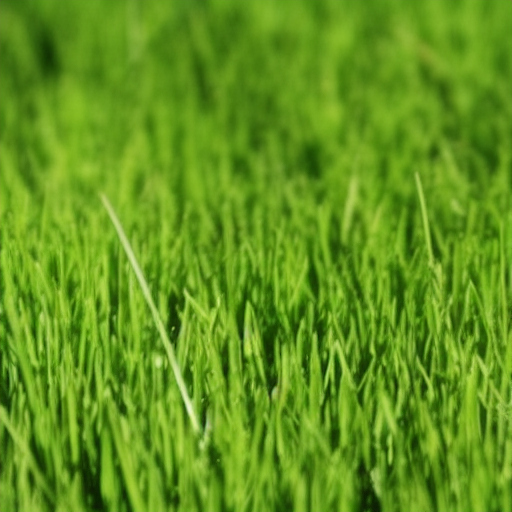

After editing:


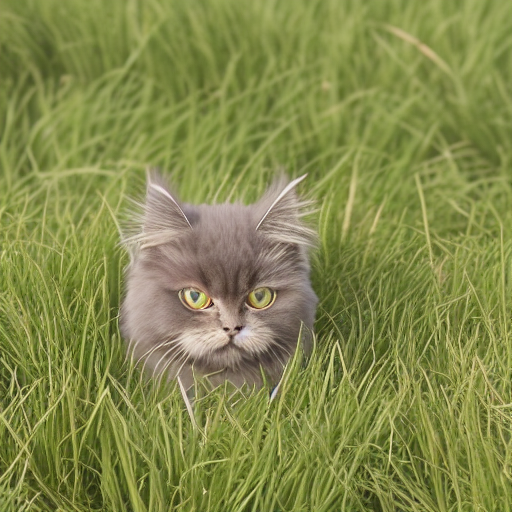

In [25]:
samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 445
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

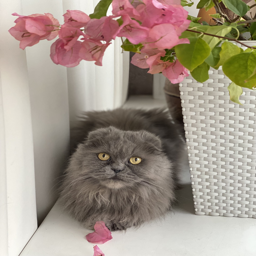

In [27]:
cond_subject = "gray cat"
src_subject = "gray tiger"
tgt_subject = "gray cat"

text_prompt = "lying on a white windowsill"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/pushok-2.jpeg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/tiger.jpg").convert("RGB")


100%|██████████| 50/50 [00:03<00:00, 15.12it/s]


['a gray tiger lying on a white windowsill', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks gray cat lying on a white windowsill']


100%|██████████| 50/50 [00:10<00:00,  4.76it/s]


Before editing:


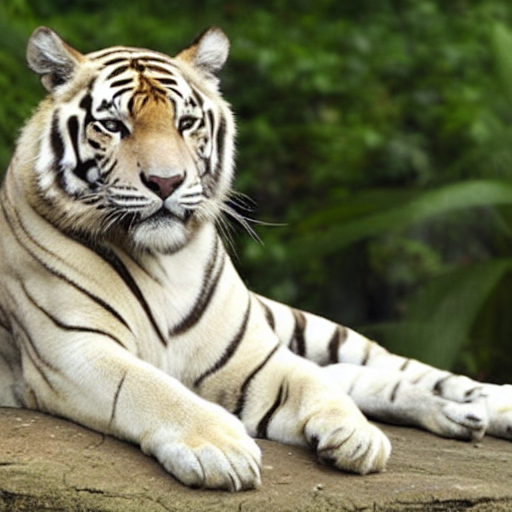

After editing:


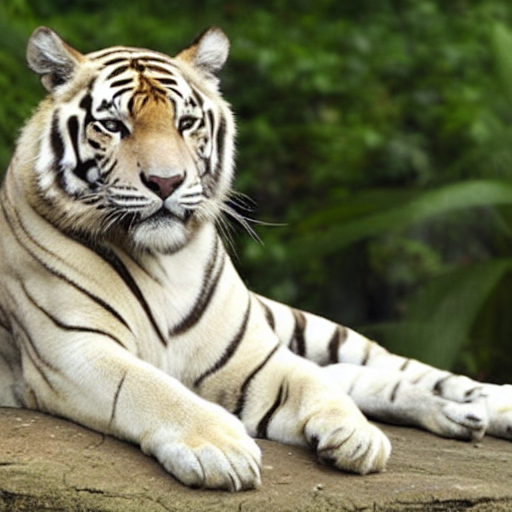

In [28]:
samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 555
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

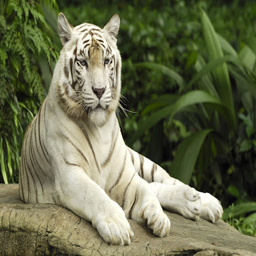

100%|██████████| 50/50 [00:03<00:00, 14.84it/s]


['a tiger lying on a white windowsill', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks gray cat lying on a white windowsill']


100%|██████████| 50/50 [00:10<00:00,  4.70it/s]


Before editing:


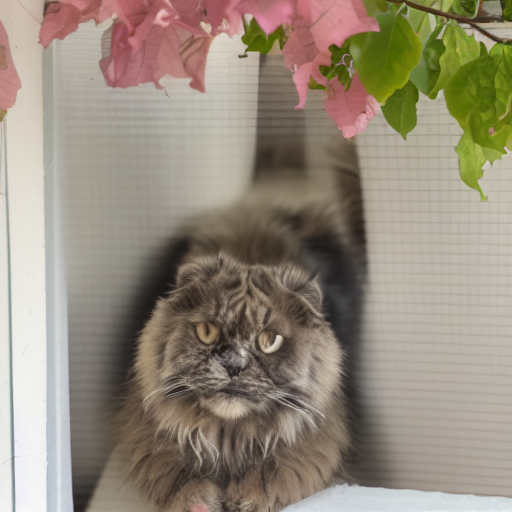

After editing:


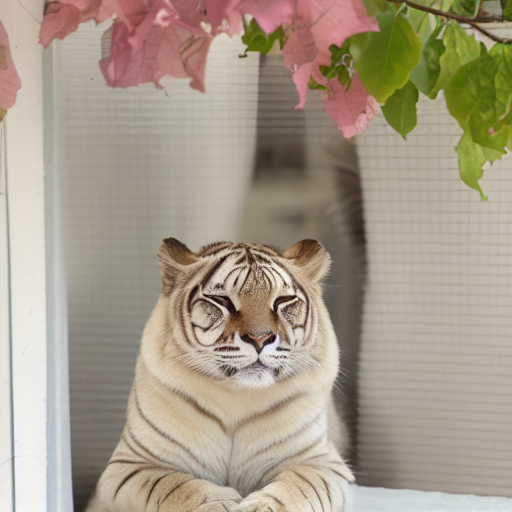

In [29]:
cond_subject = "tiger"
src_subject = "tiger"
tgt_subject = "gray cat"

text_prompt = "lying on a white windowsill"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/tiger.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/pushok-2.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 445
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

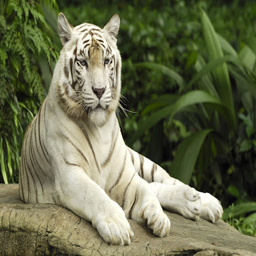

100%|██████████| 50/50 [00:03<00:00, 15.10it/s]


['a gray cat lying on a white windowsill', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks tiger lying on a white windowsill']


100%|██████████| 50/50 [00:10<00:00,  4.75it/s]


Before editing:


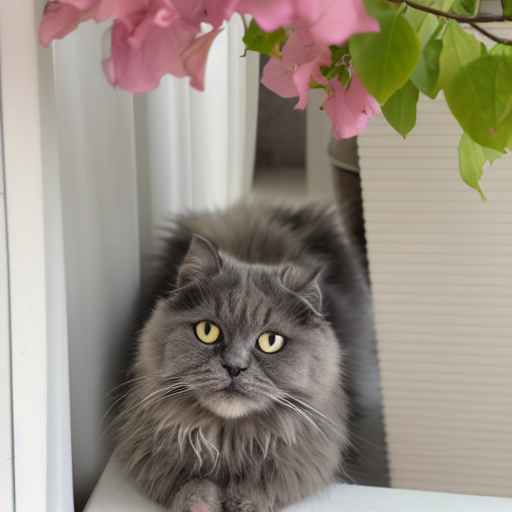

After editing:


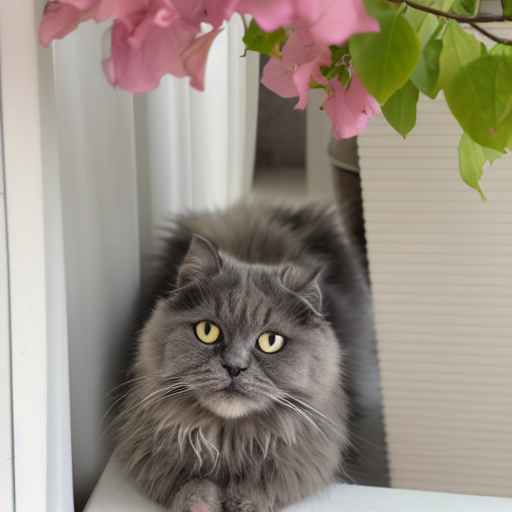

In [31]:
cond_subject = "tiger"
src_subject = "gray cat"
tgt_subject = "tiger"

text_prompt = "lying on a white windowsill"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/tiger.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/pushok-2.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 4580445
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

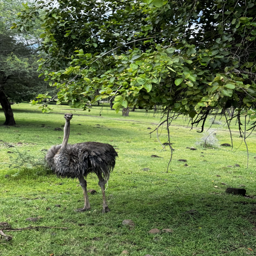

100%|██████████| 50/50 [00:03<00:00, 15.12it/s]


['a ostrich in a forest', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks ostrich in a forest']


100%|██████████| 50/50 [00:10<00:00,  4.75it/s]


Before editing:


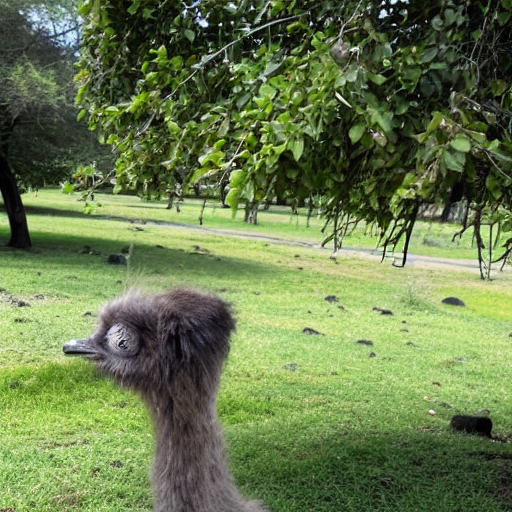

After editing:


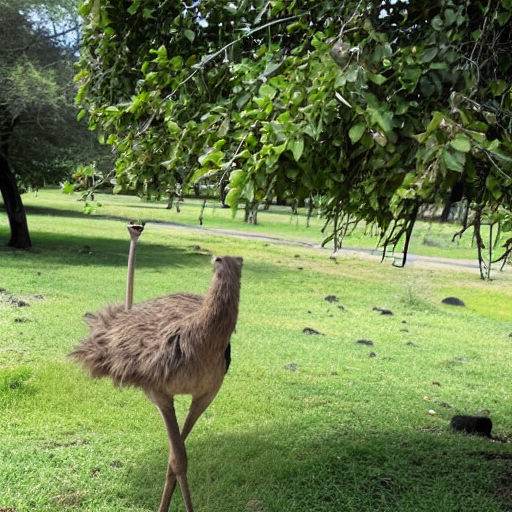

In [33]:
cond_subject = "ostrich"
src_subject = "ostrich"
tgt_subject = "ostrich"

text_prompt = "in a forest"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/ostrich.jpeg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/ostrich.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 666
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

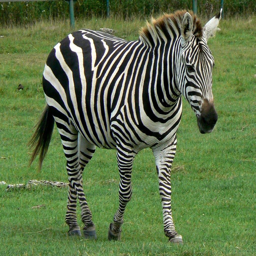

100%|██████████| 50/50 [00:03<00:00, 15.11it/s]


['a ostrich in a forest', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks zebra in a forest']


100%|██████████| 50/50 [00:10<00:00,  4.75it/s]


Before editing:


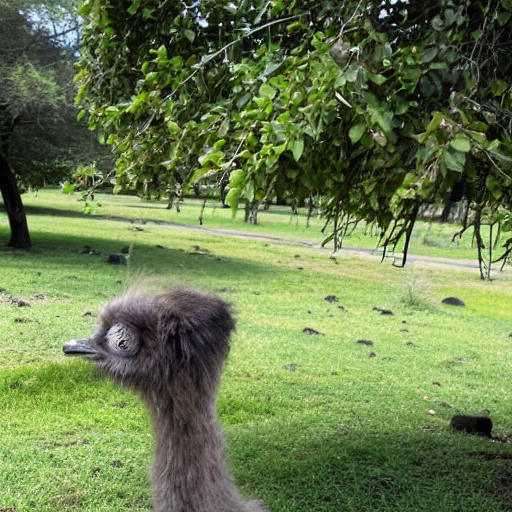

After editing:


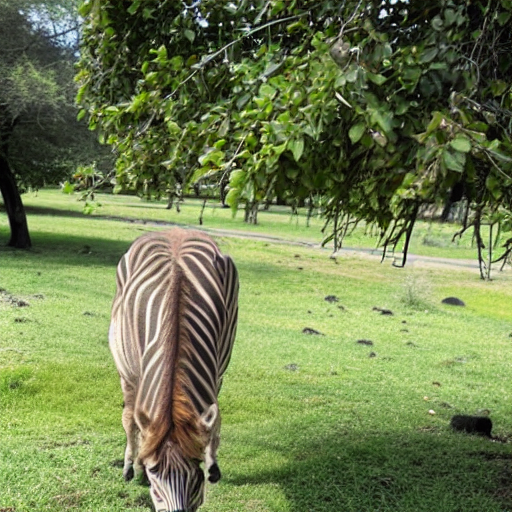

In [34]:
cond_subject = "zebra"
src_subject = "ostrich"
tgt_subject = "zebra"

text_prompt = "in a forest"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/zebra.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/ostrich.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 666
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

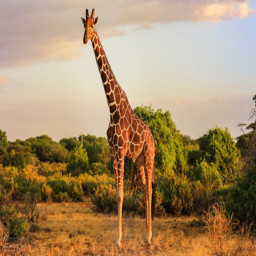

100%|██████████| 50/50 [00:03<00:00, 15.05it/s]


['a ostrich in a forest', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks giraffe in a forest']


100%|██████████| 50/50 [00:10<00:00,  4.68it/s]


Before editing:


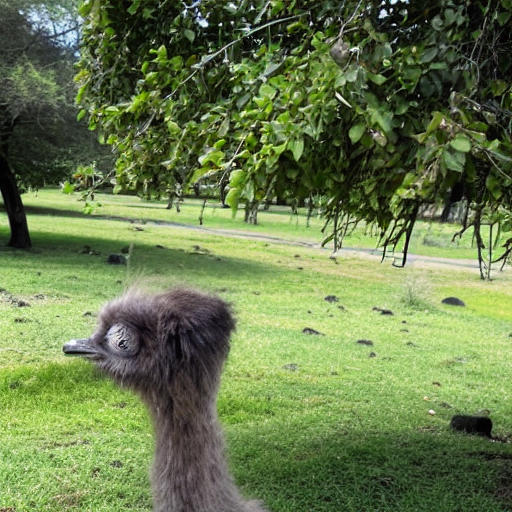

After editing:


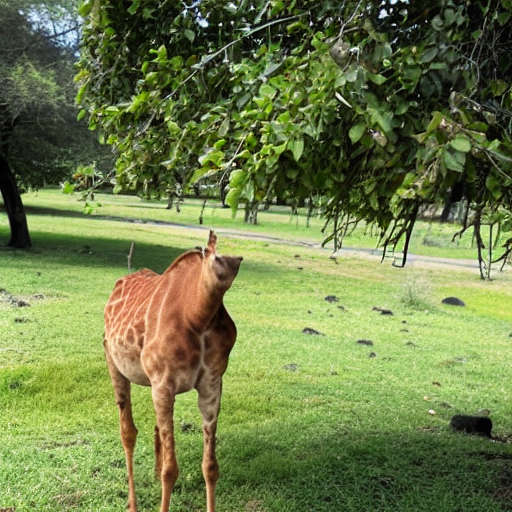

In [35]:
cond_subject = "giraffe"
src_subject = "ostrich"
tgt_subject = "giraffe"

text_prompt = "in a forest"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/giraffe.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/ostrich.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 666
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

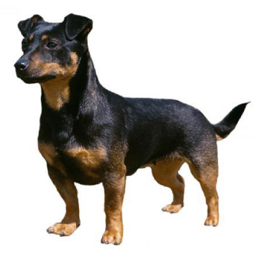

100%|██████████| 50/50 [00:03<00:00, 14.66it/s]


['a ostrich in a forest', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks dog in a forest']


100%|██████████| 50/50 [00:10<00:00,  4.68it/s]


Before editing:


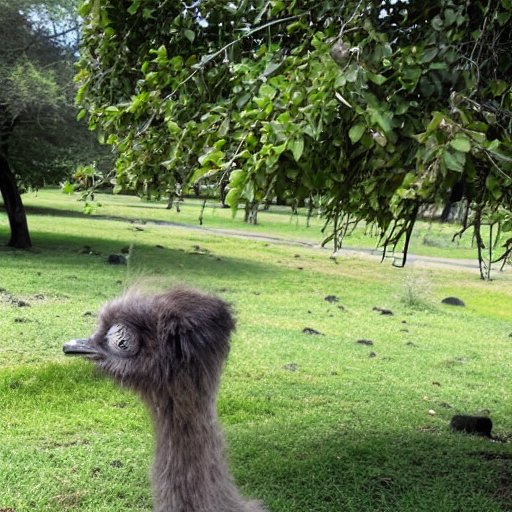

After editing:


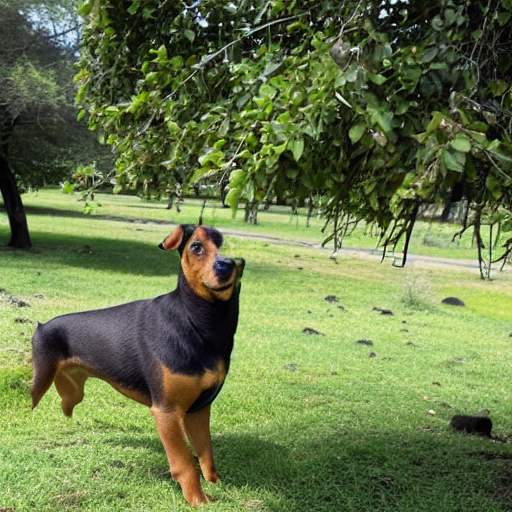

In [49]:
cond_subject = "dog"
src_subject = "ostrich"
tgt_subject = "dog"

text_prompt = "in a forest"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/lancashire-heeler.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/ostrich.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 666
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

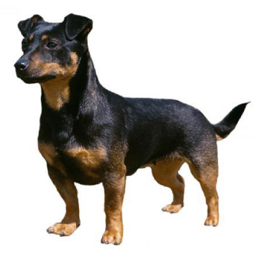

100%|██████████| 50/50 [00:03<00:00, 14.73it/s]


['a dog in a forest', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks dog in a forest']


100%|██████████| 50/50 [00:10<00:00,  4.67it/s]


Before editing:


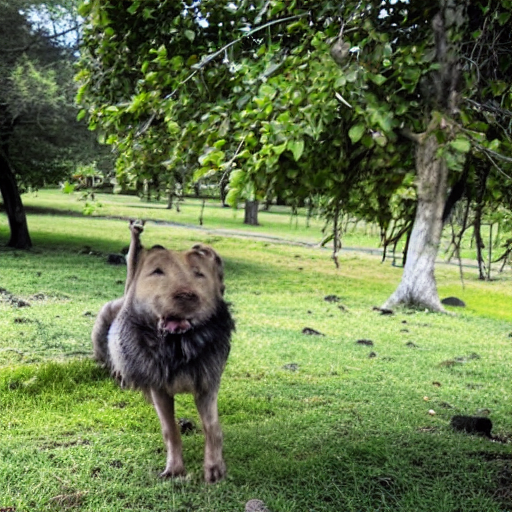

After editing:


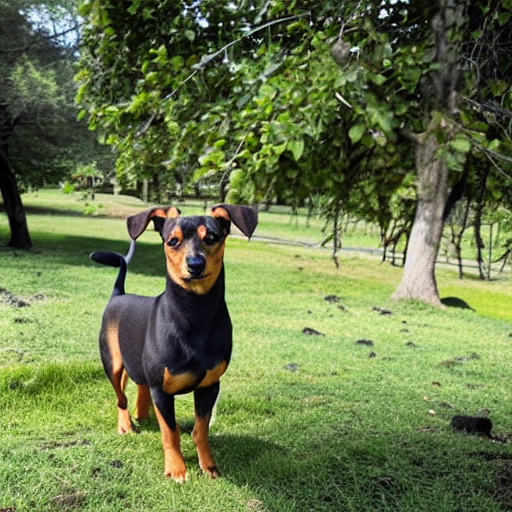

In [51]:
cond_subject = "dog"
src_subject = "dog"
tgt_subject = "dog"

text_prompt = "in a forest"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/lancashire-heeler.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/ostrich.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 666
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

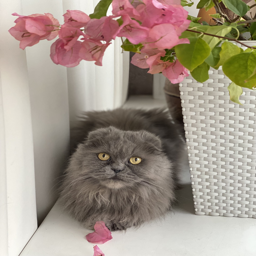

100%|██████████| 50/50 [00:03<00:00, 15.05it/s]


['a gray cat lying on a white windowsill', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks gray cat lying on a white windowsill']


100%|██████████| 50/50 [00:10<00:00,  4.74it/s]


Before editing:


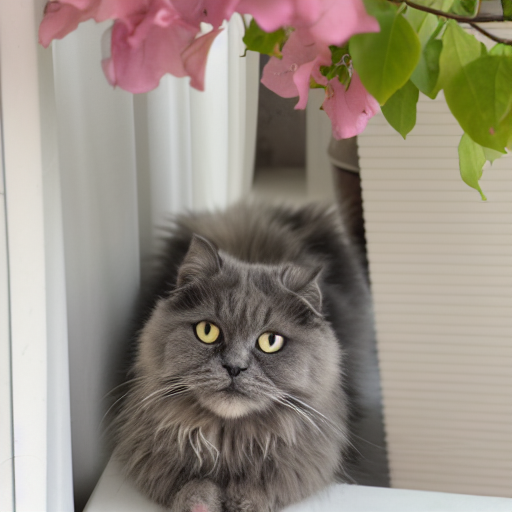

After editing:


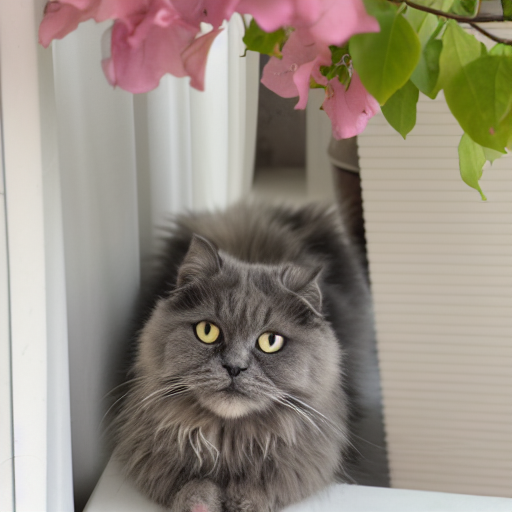

In [38]:
cond_subject = "gray cat"
src_subject = "gray cat"
tgt_subject = "gray cat"

text_prompt = "lying on a white windowsill"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/pushok-2.jpeg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/pushok-2.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 666
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

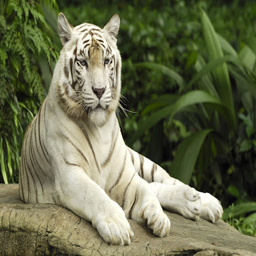

100%|██████████| 50/50 [00:03<00:00, 14.63it/s]


['a gray cat lying on a white windowsill', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks gray tiger lying on a white windowsill']


100%|██████████| 50/50 [00:10<00:00,  4.62it/s]


Before editing:


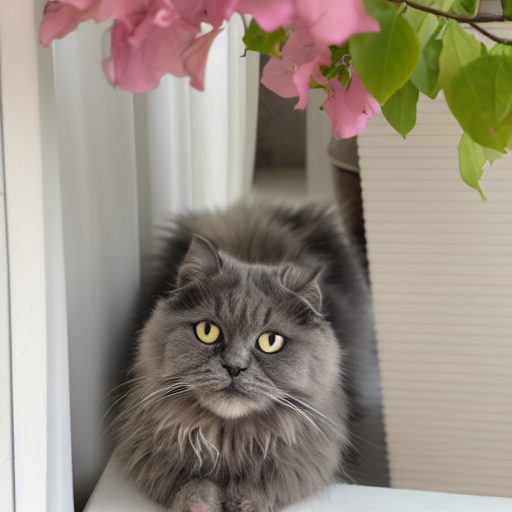

After editing:


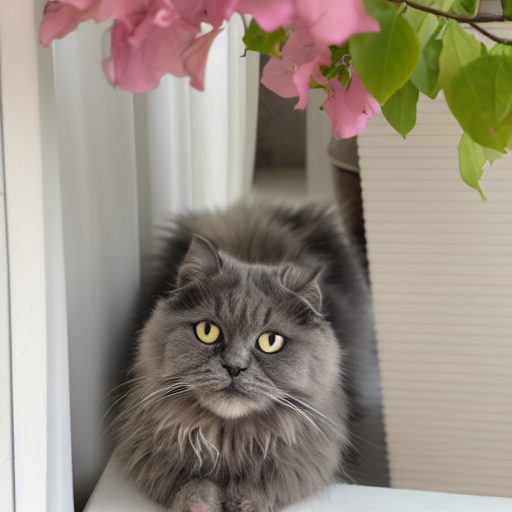

In [43]:
cond_subject = "gray tiger"
src_subject = "gray cat"
tgt_subject = "gray tiger"

text_prompt = "lying on a white windowsill"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/tiger.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/pushok-2.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 445
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

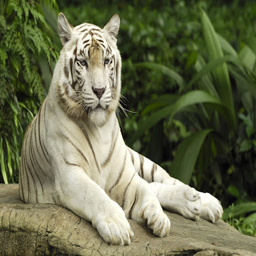

100%|██████████| 50/50 [00:03<00:00, 14.86it/s]


['a gray tiger lying on a white windowsill', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks gray tiger lying on a white windowsill']


100%|██████████| 50/50 [00:10<00:00,  4.72it/s]


Before editing:


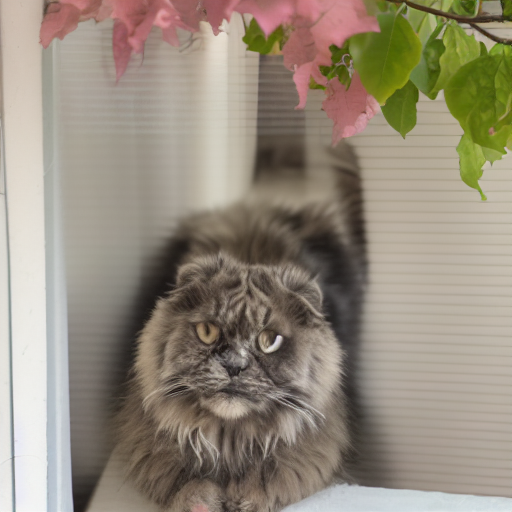

After editing:


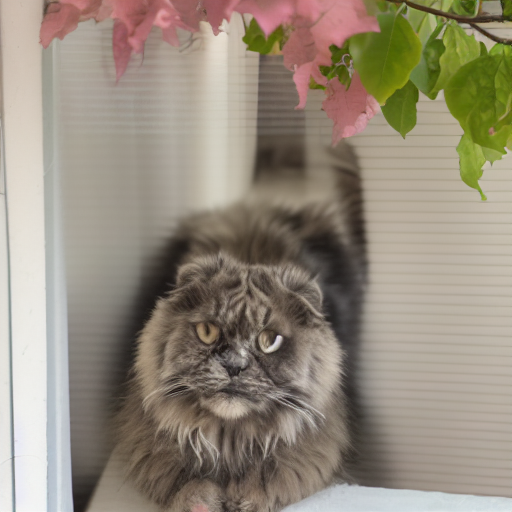

In [50]:
cond_subject = "gray tiger"
src_subject = "gray tiger"
tgt_subject = "gray tiger"

text_prompt = "lying on a white windowsill"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/tiger.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/pushok-2.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 445
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

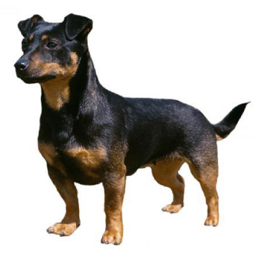

100%|██████████| 50/50 [00:03<00:00, 15.09it/s]


['a dog in a forest', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks dog in a forest']


100%|██████████| 50/50 [00:10<00:00,  4.82it/s]


Before editing:


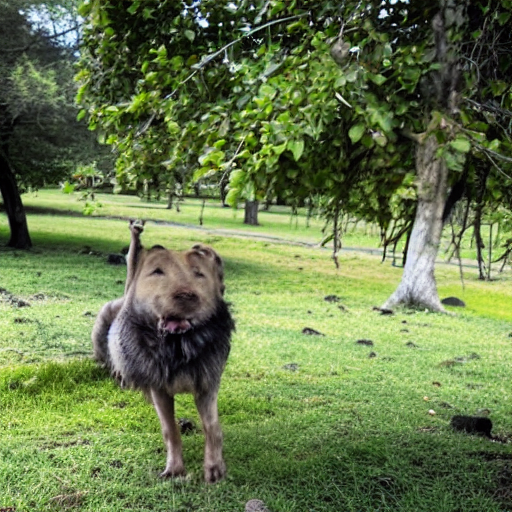

After editing:


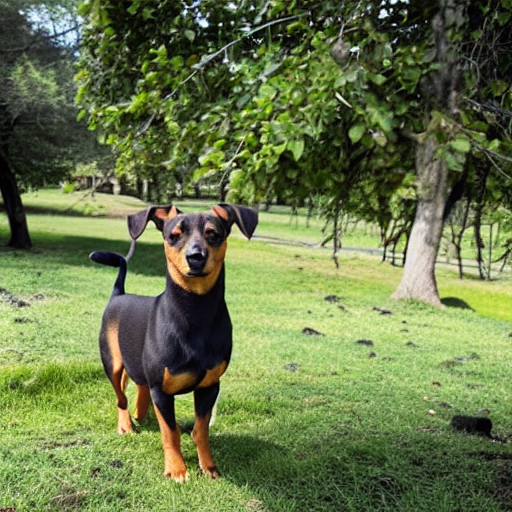

In [52]:
cond_subject = "dog"
src_subject = "dog"
tgt_subject = "dog"

text_prompt = "in a forest"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/lancashire-heeler.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/ostrich.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 1488
guidance_scale = 7.5
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

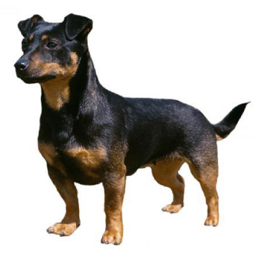

  hidden_states = F.scaled_dot_product_attention(

  self.unet.in_channels,

  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)

100%|██████████| 50/50 [00:03<00:00, 15.42it/s]


['a dog in a forest', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks dog in a forest']


100%|██████████| 50/50 [00:10<00:00,  4.73it/s]


Before editing:


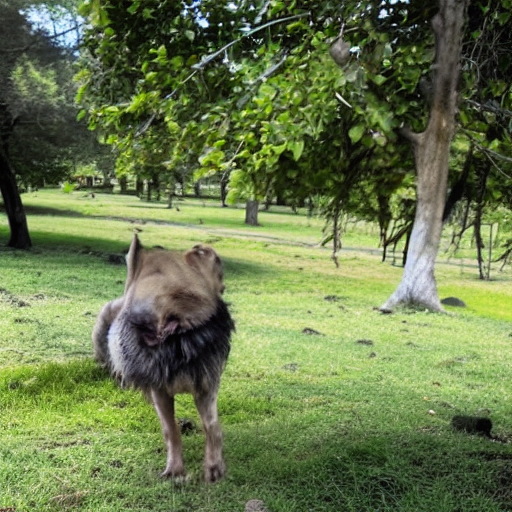

After editing:


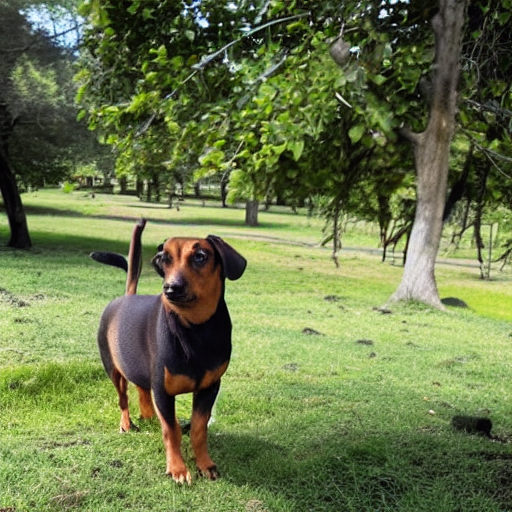

In [5]:
cond_subject = "dog"
src_subject = "dog"
tgt_subject = "dog"

text_prompt = "in a forest"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/lancashire-heeler.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/ostrich.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 1487
guidance_scale = 3
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])

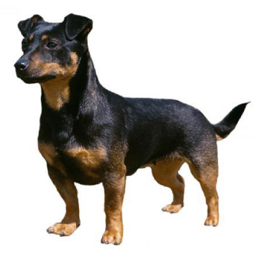

  hidden_states = F.scaled_dot_product_attention(

  self.unet.in_channels,

  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)

100%|██████████| 50/50 [00:03<00:00, 15.28it/s]


['a ostrich in a forest', 'a sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks sks dog in a forest']


100%|██████████| 50/50 [00:10<00:00,  4.73it/s]


Before editing:


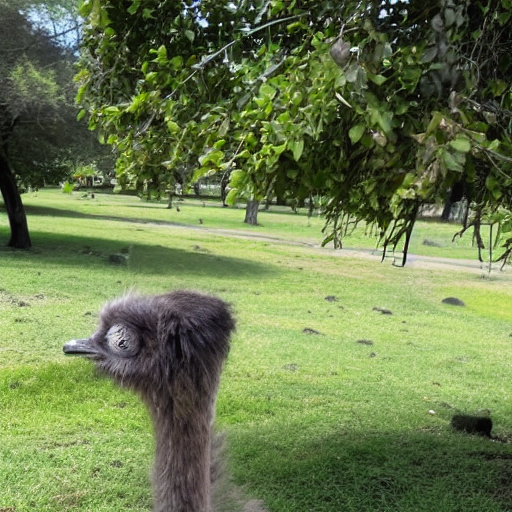

After editing:


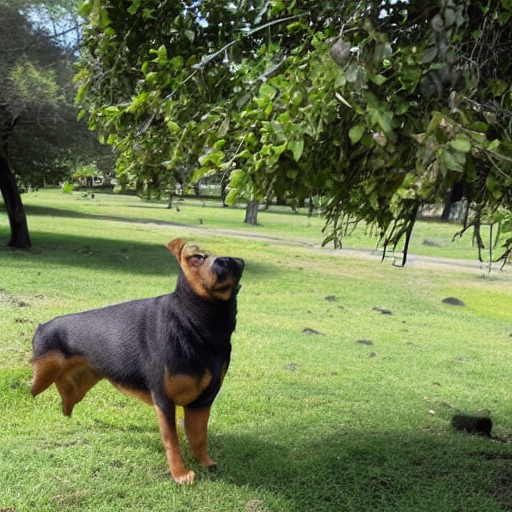

In [4]:
cond_subject = "dog"
src_subject = "ostrich"
tgt_subject = "dog"

text_prompt = "in a forest"

src_subject = txt_preprocess["eval"](src_subject)
tgt_subject = txt_preprocess["eval"](tgt_subject)
cond_subject = txt_preprocess["eval"](cond_subject)
text_prompt = [txt_preprocess["eval"](text_prompt)]

cond_image = Image.open("../images/lancashire-heeler.jpg").convert("RGB")
display(cond_image.resize((256, 256)))
cond_image = vis_preprocess["eval"](cond_image).unsqueeze(0).cuda()

src_image = Image.open("../images/ostrich.jpeg").convert("RGB")

samples = {
    "cond_images": cond_image,
    "cond_subject": cond_subject,
    "src_subject": src_subject,
    "tgt_subject": tgt_subject,
    "prompt": text_prompt,
    "raw_image": src_image,
}

iter_seed = 1486
guidance_scale = 3
num_inference_steps = 50
num_inversion_steps = 50 # increase to improve DDIM inversion quality
negative_prompt = "over-exposure, under-exposure, saturated, duplicate, out of frame, lowres, cropped, worst quality, low quality, jpeg artifacts, morbid, mutilated, out of frame, ugly, bad anatomy, bad proportions, deformed, blurry, duplicate"

output = model.edit(
    samples,
    seed=iter_seed,
    guidance_scale=guidance_scale,
    num_inference_steps=num_inference_steps,
    num_inversion_steps=num_inversion_steps,
    neg_prompt=negative_prompt,
)

print("=" * 30)
print("Before editing:")
display(output[0])

print("After editing:")
display(output[1])